In [1]:
import pandas as pd
import plotly.express as px
import seaborn as sns

In [2]:
diamonds = pd.read_csv("diamonds.csv.zip")
diamonds.head()

,Unnamed: 0,carat,cut,color,clarity,depth,table,price,x,y,z
0,1,0.23,Ideal,E,SI2,61.5,55.0,326,3.95,3.98,2.43
1,2,0.21,Premium,E,SI1,59.8,61.0,326,3.89,3.84,2.31
2,3,0.23,Good,E,VS1,56.9,65.0,327,4.05,4.07,2.31
3,4,0.29,Premium,I,VS2,62.4,58.0,334,4.20,4.23,2.63
4,5,0.31,Good,J,SI2,63.3,58.0,335,4.34,4.35,2.75


# Histograms and bar charts of each field
If the field is numerical, histogram. If the field is categorical, bar chart.

In [3]:
px.histogram(diamonds, x="carat")

In [4]:
px.histogram(diamonds, x="cut", 
             category_orders={"cut":["Fair", "Good", "Very Good", "Premium", "Ideal"]})

In [5]:
px.histogram(diamonds, x="color",
             category_orders={"color":["D","E","F","G","H","I","J"]})

In [6]:
px.histogram(diamonds, x="clarity",
             category_orders={"clarity":["I1", "SI2", "SI1", "VS2", "VS1", "VVS2", "VVS1", "IF"]})

In [7]:
px.histogram(diamonds, x="depth")

In [8]:
px.histogram(diamonds, x="table")

In [9]:
px.histogram(diamonds, x="price")

In [10]:
px.histogram(diamonds, x="x")

In [11]:
px.histogram(diamonds, x="y")

In [12]:
px.histogram(diamonds, x="z")

# Depth per cut
## Boxplots

In [13]:
px.box(diamonds, x="cut", y="depth",
       category_orders={"cut":["Fair", "Good", "Very Good", "Premium", "Ideal"]})

## Violin plots

In [14]:
px.violin(diamonds, x="cut", y="depth",
          category_orders={"cut":["Fair", "Good", "Very Good", "Premium", "Ideal"]})

## Bar with error bars
The bar indicates the mean of the depth. The error bars indicate the standard deviation. You can find some documentation here:
* Bar chart: https://plotly.com/python-api-reference/generated/plotly.express.bar.html
* Error bars: https://plotly.com/python/error-bars/


In [15]:
diamonds.groupby(['cut']).mean()

,Unnamed: 0,carat,depth,table,price,x,y,z
cut,,,,,,,,
Fair,24147.357764,1.046137,64.041677,59.053789,4358.757764,6.246894,6.182652,3.982770
Good,24774.931309,0.849185,62.365879,58.694639,3928.864452,5.838785,5.850744,3.639507
Ideal,29047.630736,0.702837,61.709401,55.951668,3457.541970,5.507451,5.520080,3.401448
Premium,25600.209049,0.891955,61.264673,58.746095,4584.257704,5.973887,5.944879,3.647124
Very Good,26097.313193,0.806381,61.818275,57.956150,3981.759891,5.740696,5.770026,3.559801


In [16]:
diamonds.groupby(['cut']).std()

,Unnamed: 0,carat,depth,table,price,x,y,z
cut,,,,,,,,
Fair,18021.165757,0.516404,3.643428,3.946261,3560.386612,0.964317,0.956380,0.651638
Good,16572.828068,0.454054,2.169374,2.851300,3681.589584,1.057301,1.051535,0.654893
Ideal,15044.527014,0.432876,0.718539,1.246423,3808.401172,1.064210,1.074495,0.657648
Premium,14917.011708,0.515262,1.158815,1.478573,4349.204961,1.188252,1.259751,0.731161
Very Good,16013.360517,0.459435,1.378631,2.121448,3935.862161,1.100839,1.102924,0.730228


In [17]:
px.bar(diamonds.groupby(['cut']).mean(),
       y='depth',
       error_y=diamonds.groupby(['cut']).std()['depth'],
       category_orders={"cut":["Fair", "Good", "Very Good", "Premium", "Ideal"]})

## Scatterplot with jittering
This cannot be done with plotly. Seaborn comes to the rescue.

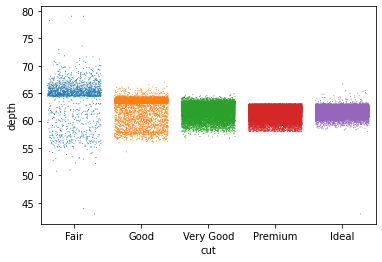

In [18]:
sns.stripplot(x='cut', y='depth', data=diamonds, jitter=0.4, size=1,
              order=["Fair", "Good", "Very Good", "Premium", "Ideal"])

# Scatterplots
## Price per carat with smaller markers, colors, and transparency
Some information about styling the markers here: https://plotly.com/python/marker-style/

In [19]:
px.scatter(diamonds, x='price', y='carat', color = 'color',
                 opacity=0.2)

In [21]:
fig = px.scatter(diamonds, x='price', y='carat', color = 'color')
fig.update_traces(marker={'size':2})

## Contour plot
* https://plotly.com/python/2d-histogram-contour/
* https://plotly.com/python/facet-plots/

In [22]:
px.density_contour(diamonds, x='price', y='carat', color='color')

In [23]:
px.density_contour(diamonds, x='price', y='carat', facet_col="color", facet_col_wrap=3)

## Sampling
Let's generate scatterplots for multiple sample sizes

In [24]:
diamonds_1000 = diamonds.sample(n=1000, random_state=1111)

In [25]:
fig = px.scatter(diamonds_1000, x='price', y='carat', color = 'color')
fig.update_traces(marker={'size':2})


In [26]:
diamonds_5000 = diamonds.sample(n=5000, random_state=1111)
fig = px.scatter(diamonds_5000, x='price', y='carat', color = 'color')
fig.update_traces(marker={'size':2})

In [27]:
diamonds_10000 = diamonds.sample(n=10000, random_state=1111)
fig = px.scatter(diamonds_10000, x='price', y='carat', color = 'color')
fig.update_traces(marker={'size':2})

A sample size of 5000 might be best for this marker size of 2.

# Multiple information
## Scatterplots of price vs. carat per cut and colour

In [28]:
fig = px.scatter(diamonds_5000, x='price', y='carat', facet_col="color", facet_col_wrap=3, color="cut")
fig.update_traces(marker={'size':2})

## Average depth per cut and colour

In [29]:
pivot = diamonds.pivot_table(index="color", columns="cut", values="depth", aggfunc="mean")
pivot

cut,Fair,Good,Ideal,Premium,Very Good
color,,,,,
D,64.048466,62.365710,61.678370,61.169245,61.750165
E,63.319643,62.203751,61.686677,61.175909,61.730250
F,63.508013,62.202310,61.675562,61.259974,61.721627
G,64.339809,62.526636,61.700164,61.279480,61.841279
H,64.585149,62.499573,61.733194,61.322034,61.968366
I,64.220571,62.475096,61.793598,61.328641,61.934551
J,64.357143,62.395765,61.821987,61.390099,61.902065


In [30]:
px.bar(pivot, barmode="group", labels={'value':'Average depth'})

In [31]:
pivot2 = diamonds.pivot_table(index=["color", "clarity"], columns="cut", values="depth", aggfunc="mean").reset_index(level=1)
pivot2

cut,clarity,Fair,Good,Ideal,Premium,Very Good
color,,,,,,
D,I1,65.600000,61.350000,61.453846,61.900000,62.200000
D,IF,60.766667,60.877778,61.496429,61.070000,61.513043
D,SI1,64.634483,62.755696,61.736179,61.254317,61.822470
D,SI2,64.703571,62.063229,61.673876,61.099287,61.743631
D,VS1,63.160000,61.597674,61.620228,61.132824,61.553143
D,VS2,62.684000,62.758654,61.688478,61.146313,61.968285
D,VVS1,61.666667,61.653846,61.710417,61.182500,61.675000
D,VVS2,61.677778,62.284000,61.584859,61.024468,61.328369
E,I1,65.644444,61.660870,61.850000,60.806667,61.481818


In [32]:
fig = px.bar(pivot2, barmode="group", labels={'value':'Average depth'}, 
            facet_col="clarity", facet_col_wrap=2)
fig.update_layout(height=700)